Casual Inference

In [1]:
import pandas as pd 
import numpy as np 
import matplotlib.pyplot as plt 
import seaborn as sns
from math import log, exp
from scipy.stats import norm, skew 
import scipy.stats as stats
from numpy import mean
from numpy import std

In [2]:
abspath = '/home/semipro321/Documents/Workspace/Geospatial-Analysis-on-House-Price-Prediction/'
df = pd.read_csv(abspath + 'Inputs/mastermodel_filledv3.csv')
df.shape
quantitative = [f for f in df.columns if df.dtypes[f] != 'object']
quantitative.remove('final_price')

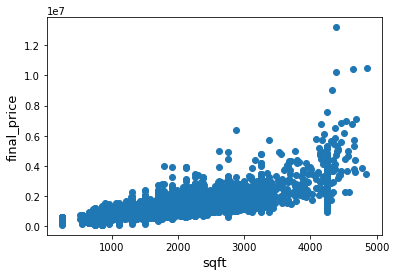

In [3]:
fig, ax = plt.subplots()
ax.scatter(x = df['sqft'], y = df['final_price'])
plt.ylabel('final_price', fontsize=13)
plt.xlabel('sqft', fontsize=13)
plt.show()

Few Outliers gotta fix that

In [4]:
# calculate summary statistics
data_mean, data_std = mean(df['final_price']), std(df['final_price'])
# identify outliers
cut_off = data_std * 3
lower, upper = data_mean - cut_off, data_mean + cut_off
outliers = [x for x in df['final_price'] if x < lower or x > upper]
df = df[df['final_price'].apply(lambda x: x > lower and x < upper)]

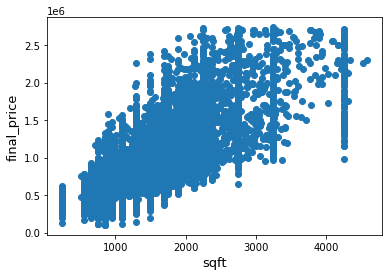

In [5]:
fig, ax = plt.subplots()
ax.scatter(x = df['sqft'], y = df['final_price'])
plt.ylabel('final_price', fontsize=13)
plt.xlabel('sqft', fontsize=13)
plt.show()

In [6]:
neighdumcol = [col for col in df.columns if 'neighbourhood' in col]
typedumcol = [col for col in df.columns if 'type' in col]
dumcol = neighdumcol + typedumcol

In [7]:
dfnotdum = df.drop(columns=dumcol)
dfnotdum.describe()

,sqft,parking,mean_district_income,bedrooms_bg,bedrooms_ag,bathrooms,final_price,dist_nearest_school,dist_nearest_ttc,Auto Theft500m,Auto Theft1000m,violent_crime1000m,violent_crime500m,Airbnb500m_YOY1519,Airbnb1000m_YOY1519,dist_nearest_park
count,14944.000000,14944.000000,14944.00000,14944.000000,14944.000000,14944.000000,1.494400e+04,14944.000000,14944.000000,14944.000000,14944.000000,14944.000000,14944.000000,14944.000000,14944.000000,14944.000000
mean,1267.659629,1.525294,54469.43576,0.531785,2.299251,2.063236,8.261101e+05,436.122307,2097.187778,38.646547,91.168763,1499.144071,619.117171,141.961188,295.183619,217.304779
std,671.712791,1.312112,29281.80309,0.664332,1.104939,1.031630,4.345626e+05,565.819672,1353.290697,28.065459,56.744562,1852.410899,789.506020,266.167501,521.041427,117.252225
min,250.000000,0.000000,25989.00000,0.000000,0.000000,1.000000,1.030000e+05,10.432917,18.820857,0.000000,2.000000,35.000000,8.000000,-3.000000,-2.000000,10.690000
25%,750.000000,1.000000,34904.00000,0.000000,1.000000,1.000000,5.310000e+05,206.941481,1089.906574,18.000000,52.000000,454.000000,175.000000,10.000000,25.000000,127.710000
50%,1100.000000,1.000000,49709.00000,0.000000,2.000000,2.000000,7.050000e+05,318.190544,1851.960385,31.000000,76.000000,748.000000,311.000000,27.000000,61.000000,198.695000
75%,1601.695282,2.000000,64140.00000,1.000000,3.000000,2.000000,9.650000e+05,488.795915,2866.232281,52.000000,115.000000,1538.500000,662.000000,142.000000,266.000000,287.590000
max,4576.629883,11.000000,308010.00000,6.000000,9.000000,11.000000,2.738000e+06,6904.513193,8775.156855,162.000000,383.000000,11911.000000,5165.000000,1585.000000,2977.000000,822.360000


It is apparent that final_price doesn't follow normal distribution, so before performing regression it has to be transformed. While log transformation does pretty good job, best fit is unbounded Johnson distribution.


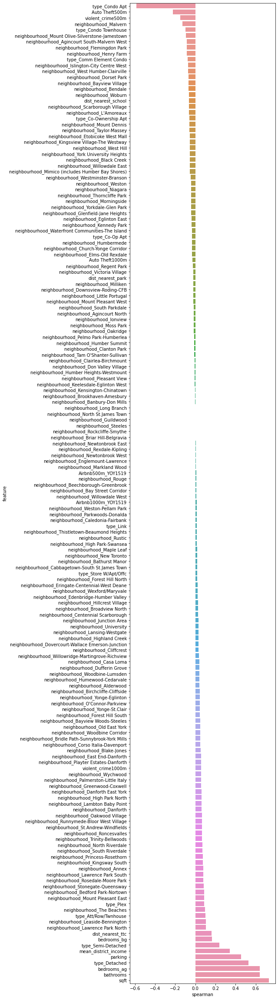

In [8]:
def spearman(frame, features):
    spr = pd.DataFrame()
    spr['feature'] = features
    spr['spearman'] = [frame[f].corr(frame['final_price'], 'spearman') for f in features]
    spr = spr.sort_values('spearman')
    plt.figure(figsize=(6, 0.25*len(features)))
    sns.barplot(data=spr, y='feature', x='spearman', orient='h')
    
features = df.drop('final_price',axis=1).columns
spearman(df, features)

In [9]:
log_col = ['sqft','mean_district_income','final_price','dist_nearest_school', 'dist_nearest_ttc', 'dist_nearest_park']


 mu = 1267.66 and sigma = 671.69



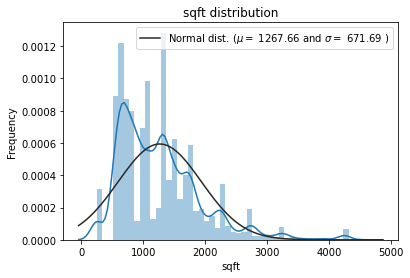

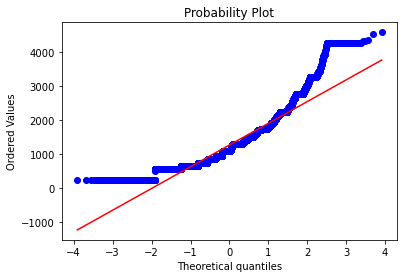


 mu = 54469.44 and sigma = 29280.82



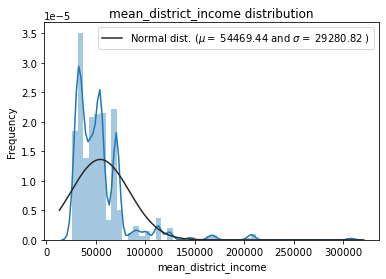

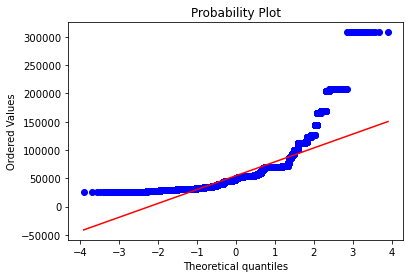


 mu = 826110.06 and sigma = 434548.01



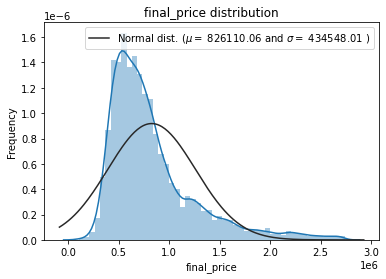

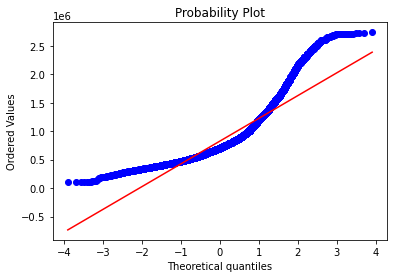


 mu = 436.12 and sigma = 565.80



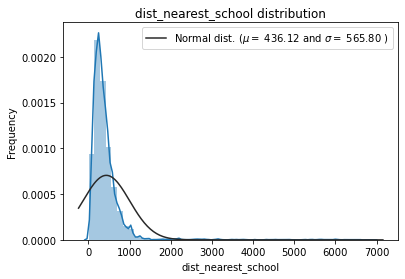

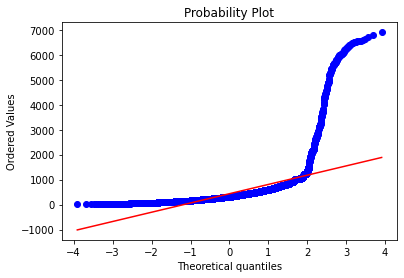


 mu = 2097.19 and sigma = 1353.25



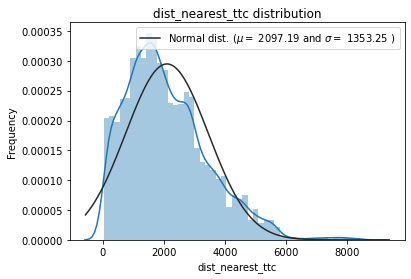

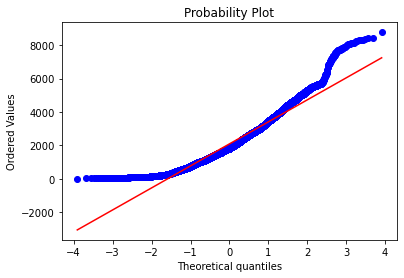


 mu = 217.30 and sigma = 117.25



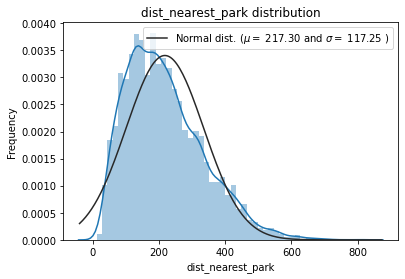

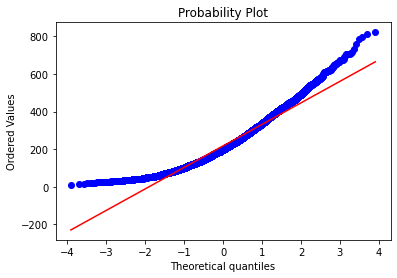

In [10]:
for i in log_col:
    sns.distplot(df[i] , fit=norm);

    # Get the fitted parameters used by the function
    (mu, sigma) = norm.fit(df[i])
    print( '\n mu = {:.2f} and sigma = {:.2f}\n'.format(mu, sigma))

    #Now plot the distribution
    plt.legend(['Normal dist. ($\mu=$ {:.2f} and $\sigma=$ {:.2f} )'.format(mu, sigma)],
                loc='best')
    plt.ylabel('Frequency')
    plt.title(f'{i} distribution')

    #Get also the QQ-plot
    fig = plt.figure()
    res = stats.probplot(df[i], plot=plt)
    plt.show()



 mu = 7.01 and sigma = 0.53



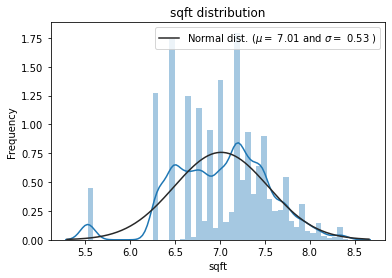

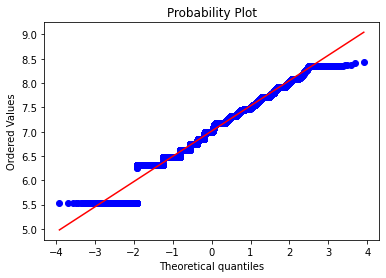


 mu = 10.81 and sigma = 0.40



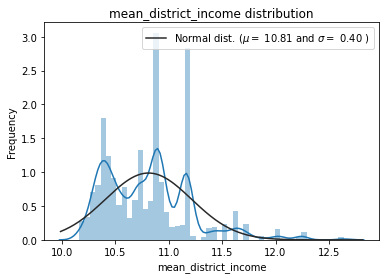

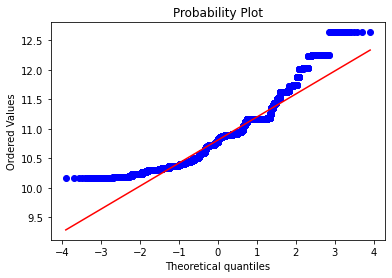


 mu = 13.51 and sigma = 0.46



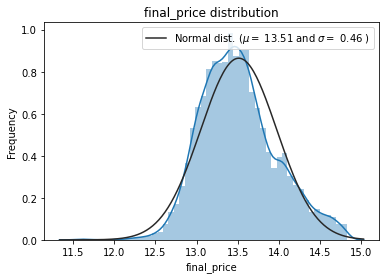

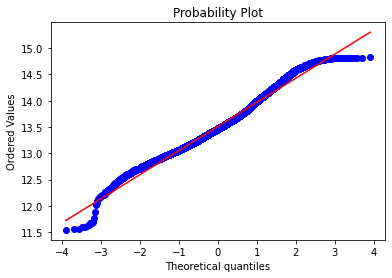


 mu = 5.77 and sigma = 0.73



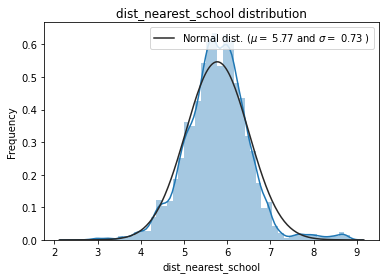

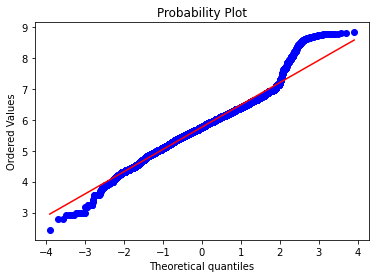


 mu = 7.38 and sigma = 0.85



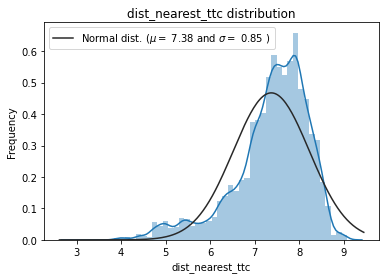

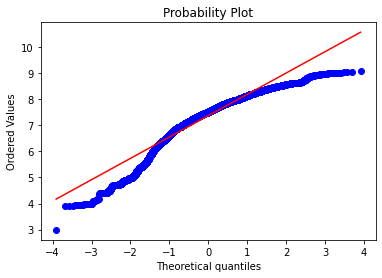


 mu = 5.23 and sigma = 0.59



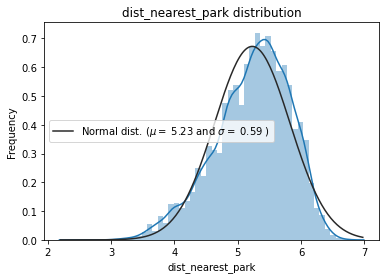

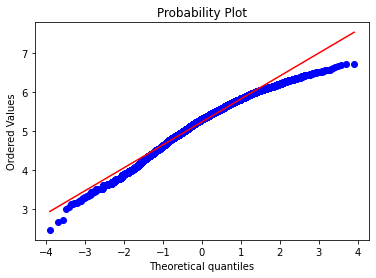

In [11]:
from scipy.special import boxcox1p
for i in log_col:
    #We use the numpy fuction log1p which  applies log(1+x) to all elements of the column
    df[i] = np.log1p(df[i])

    #Check the new distribution 
    sns.distplot(df[i] , fit=norm);

    # Get the fitted parameters used by the function
    (mu, sigma) = norm.fit(df[i])
    print( '\n mu = {:.2f} and sigma = {:.2f}\n'.format(mu, sigma))

    #Now plot the distribution
    plt.legend(['Normal dist. ($\mu=$ {:.2f} and $\sigma=$ {:.2f} )'.format(mu, sigma)],
                loc='best')
    plt.ylabel('Frequency')
    plt.title(f'{i} distribution')

    #Get also the QQ-plot
    fig = plt.figure()
    res = stats.probplot(df[i], plot=plt)
    plt.show()

In [12]:
from sklearn.model_selection import train_test_split
X =df.drop('final_price', axis=1)
y = df['final_price']

X_train, X_test, y_train, y_test = train_test_split(X,y,test_size=0.3,random_state=23)

In [13]:
from sklearn.linear_model import LinearRegression 

reg = LinearRegression().fit(X_train, y_train)
reg.score(X_train,y_train)

0.8827584907294103

In [14]:
# The parameters for linear regression model
X_0 = np.c_[np.ones((X_train.shape[0],1)),X_train]
parameter = ['theta_'+str(i) for i in range(X_0.shape[1])]
columns = ['intersect:x_0=1'] + list(X.columns.values)
parameter_df = pd.DataFrame({'Parameter':parameter,'Columns':columns})

In [15]:
sk_theta = [reg.intercept_]+list(reg.coef_)
parameter_df = parameter_df.join(pd.Series(sk_theta, name='Sklearn_theta'))
parameter_df

,Parameter,Columns,Sklearn_theta
0,theta_0,intersect:x_0=1,5.522874
1,theta_1,sqft,0.441953
2,theta_2,parking,0.026928
3,theta_3,mean_district_income,0.433327
4,theta_4,bedrooms_bg,-0.001546
...,...,...,...
162,theta_162,violent_crime1000m,0.000002
163,theta_163,violent_crime500m,0.000011
164,theta_164,Airbnb500m_YOY1519,0.000019
165,theta_165,Airbnb1000m_YOY1519,-0.000001


In [16]:
y_pred = reg.predict(X_test)
#Evaluvation: MSE
from sklearn.metrics import mean_squared_error
mse = mean_squared_error(y_pred, y_test)

# R_square
R_square = reg.score(X_test,y_test)
print('The Mean Square Error(MSE) or J(theta) is: ',mse)
print('R square obtain for scikit learn library is :',R_square)

The Mean Square Error(MSE) or J(theta) is:  0.025541583602032566
R square obtain for scikit learn library is : 0.8750646823012515


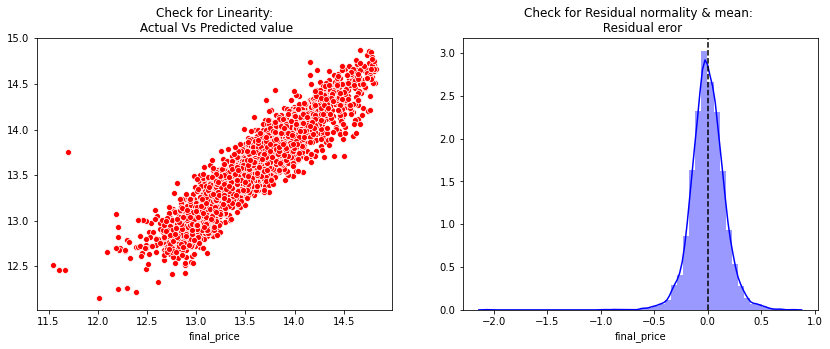

In [17]:
# Check for Linearity
f = plt.figure(figsize=(14,5))
ax = f.add_subplot(121)
sns.scatterplot(y_test,y_pred,ax=ax,color='r')
ax.set_title('Check for Linearity:\n Actual Vs Predicted value')

# Check for Residual normality & mean
ax = f.add_subplot(122)
sns.distplot((y_test - y_pred),ax=ax,color='b')
ax.axvline((y_test - y_pred).mean(),color='k',linestyle='--')
ax.set_title('Check for Residual normality & mean: \n Residual eror');

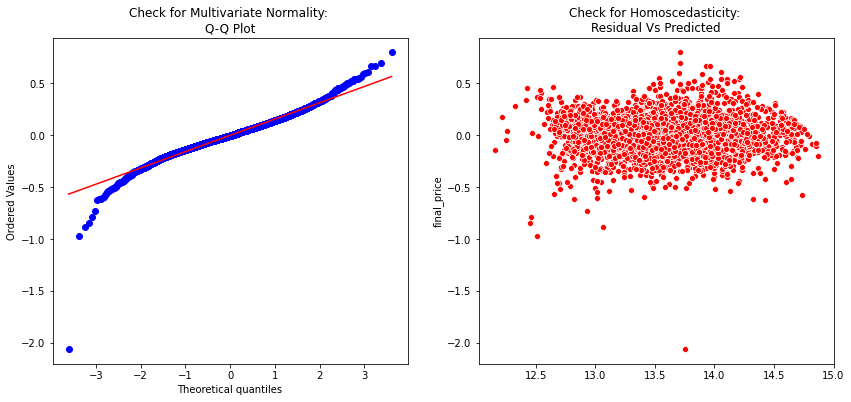

In [18]:
# Check for Multivariate Normality
# Quantile-Quantile plot 
f,ax = plt.subplots(1,2,figsize=(14,6))
import scipy as sp
_,(_,_,r)= sp.stats.probplot((y_test - y_pred),fit=True,plot=ax[0])
ax[0].set_title('Check for Multivariate Normality: \nQ-Q Plot')

#Check for Homoscedasticity
sns.scatterplot(y = (y_test - y_pred), x= y_pred, ax = ax[1],color='r') 
ax[1].set_title('Check for Homoscedasticity: \nResidual Vs Predicted');

In [19]:
# Check for Multicollinearity
#Variance Inflation Factor
VIF = 1/(1- R_square)
VIF

8.004141810494765

The model assumption linear regression as follows

1. In our model the actual vs predicted plot is straight so linear assumption true  

2. The residual mean is zero and residual error plot is normal. So normality is good

3. Q-Q plot shows as value log value greater than 2 trends to increase  

4. The plot is exhibit heteroscedastic, error will insease after certian point.  

5. Variance inflation factor value is more than 5, so multicollearity but still under 10 so its ok.

In [20]:
import statsmodels.api as sm
ols = sm.OLS(y,X)
fii = ols.fit()

0. intersect:x_0=1 
1. sqft 
2. parking 
3. mean_district_income 
4. bedrooms_bg 
5. bedrooms_ag 
6. bathrooms 
7. type_Att/Row/Twnhouse 
8. type_Co-Op Apt 
9. type_Co-Ownership Apt 
10. type_Comm Element Condo 
11. type_Condo Apt 
12. type_Condo Townhouse 
13. type_Detached 
14. type_Link 
15. type_Plex 
16. type_Semi-Detached 
17. type_Store W/Apt/Offc 
18. dist_nearest_school 
19. dist_nearest_ttc 
20. neighbourhood_Agincourt North 
21. neighbourhood_Agincourt South-Malvern West 
22. neighbourhood_Alderwood 
23. neighbourhood_Annex 
24. neighbourhood_Banbury-Don Mills 
25. neighbourhood_Bathurst Manor 
26. neighbourhood_Bay Street Corridor 
27. neighbourhood_Bayview Village 
28. neighbourhood_Bayview Woods-Steeles 
29. neighbourhood_Bedford Park-Nortown 
30. neighbourhood_Beechborough-Greenbrook 
31. neighbourhood_Bendale 
32. neighbourhood_Birchcliffe-Cliffside 
33. neighbourhood_Black Creek 
34. neighbourhood_Blake-Jones 
35. neighbourhood_Briar Hill-Belgravia 
36. neighbourhood_B

In [21]:
print(fii.summary())

                            OLS Regression Results                            
Dep. Variable:            final_price   R-squared:                       0.881
Model:                            OLS   Adj. R-squared:                  0.880
Method:                 Least Squares   F-statistic:                     671.9
Date:                Sun, 21 Mar 2021   Prob (F-statistic):               0.00
Time:                        22:37:40   Log-Likelihood:                 6264.0
No. Observations:               14944   AIC:                        -1.220e+04
Df Residuals:                   14780   BIC:                        -1.095e+04
Df Model:                         163                                         
Covariance Type:            nonrobust                                         
                                                        coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------------------------------------------

Airbnb had almost no effect
Spatial Error

In [22]:
from sklearn.preprocessing import StandardScaler
from sklearn.pipeline import make_pipeline

linearstandard = make_pipeline(StandardScaler(), LinearRegression())

In [23]:
import statsmodels.api as sm
from scipy.stats.mstats import zscore

print (sm.OLS(zscore(y), zscore(X)).fit().summary())

                                 OLS Regression Results                                
Dep. Variable:                      y   R-squared (uncentered):                   0.881
Model:                            OLS   Adj. R-squared (uncentered):              0.880
Method:                 Least Squares   F-statistic:                              672.0
Date:                Sun, 21 Mar 2021   Prob (F-statistic):                        0.00
Time:                        22:37:40   Log-Likelihood:                         -5293.3
No. Observations:               14944   AIC:                                  1.091e+04
Df Residuals:                   14781   BIC:                                  1.215e+04
Df Model:                         163                                                  
Covariance Type:            nonrobust                                                  
                 coef    std err          t      P>|t|      [0.025      0.975]
-----------------------------------------

In [24]:
for i,col in enumerate(X.columns):
    i = i+1
    print(f'{i}. {col} ')

1. sqft 
2. parking 
3. mean_district_income 
4. bedrooms_bg 
5. bedrooms_ag 
6. bathrooms 
7. type_Att/Row/Twnhouse 
8. type_Co-Op Apt 
9. type_Co-Ownership Apt 
10. type_Comm Element Condo 
11. type_Condo Apt 
12. type_Condo Townhouse 
13. type_Detached 
14. type_Link 
15. type_Plex 
16. type_Semi-Detached 
17. type_Store W/Apt/Offc 
18. dist_nearest_school 
19. dist_nearest_ttc 
20. neighbourhood_Agincourt North 
21. neighbourhood_Agincourt South-Malvern West 
22. neighbourhood_Alderwood 
23. neighbourhood_Annex 
24. neighbourhood_Banbury-Don Mills 
25. neighbourhood_Bathurst Manor 
26. neighbourhood_Bay Street Corridor 
27. neighbourhood_Bayview Village 
28. neighbourhood_Bayview Woods-Steeles 
29. neighbourhood_Bedford Park-Nortown 
30. neighbourhood_Beechborough-Greenbrook 
31. neighbourhood_Bendale 
32. neighbourhood_Birchcliffe-Cliffside 
33. neighbourhood_Black Creek 
34. neighbourhood_Blake-Jones 
35. neighbourhood_Briar Hill-Belgravia 
36. neighbourhood_Bridle Path-Sunnybroo

In [25]:
X.drop(columns=['bedrooms_bg', 'Auto Theft1000m', 'violent_crime1000m', 'Airbnb1000m_YOY1519'],inplace=True)

In [26]:
print (sm.OLS(zscore(y), zscore(X)).fit().summary())

                                 OLS Regression Results                                
Dep. Variable:                      y   R-squared (uncentered):                   0.881
Model:                            OLS   Adj. R-squared (uncentered):              0.880
Method:                 Least Squares   F-statistic:                              687.5
Date:                Sun, 21 Mar 2021   Prob (F-statistic):                        0.00
Time:                        22:37:40   Log-Likelihood:                         -5308.6
No. Observations:               14944   AIC:                                  1.094e+04
Df Residuals:                   14785   BIC:                                  1.215e+04
Df Model:                         159                                                  
Covariance Type:            nonrobust                                                  
                 coef    std err          t      P>|t|      [0.025      0.975]
-----------------------------------------

In [27]:
df['violent_crime500m'].median()

311.0